## Predicciones de Riesgos de Accidentes de Tránsito con Machine Learning

Los accidentes de tránsito son uno de los eventos lamentables que experimenta cualquier nación. En este notebook, se analiza la utlización de diferentes técnicas de *machine learning* para la predicción de riesgos asociados a dichos accidentes.

### Objetivo General

- Utilizar Machine learning para la predicción de riesgos asociados de accidentes de tránsito
- Analizar y agrupar áreas geográficas con características similares en términos de siniestralidad vial mediante técnicas de clustering, con el fin de identificar patrones y tendencias que contribuyan a la formulación de estrategias de prevención y mejora de la seguridad vial

### Objetivos Específicos
- Aplicar técnicas de clustering como K-Means, para agrupar áreas geográficas con características similares en términos de siniestralidad además de evaluar la idoneidad de diferentes enfoques y parámetros de clustering 
- Investigar y analizar patrones emergentes en los grupos identificados, centrándose en las similitudes y diferencias clave entre las áreas agrupadas.
- Establecer relaciones causales entre variables identificadas y la frecuencia de siniestros
- Evaluar la validez de los grupos formados mediante técnicas de validación interna y externa

### Hipótesis
- Evaluación de riesgos en seguridad vial, uso de técnicas avanzadas de Machine Learning
- Técnicas de aprendizaje automático en datos abiertos de siniestros de tránsito



## Lectura Dataset

Se realiza la lectura de los datos originales del ANT

In [1]:
import pandas as pd
import os
dataset_path = os.path.join(os.getcwd(), 'data', 'dataset_original.xlsx')
dataset = pd.read_excel(dataset_path)
dataset.shape

(165017, 60)

In [2]:
pd.set_option('display.max_columns', None)
# pd.options.display.max_rows = None

In [3]:
dataset.sample(5)

,NUMERO,ANIO,SINIESTROS,LESIONADOS,FALLECIDOS,ENTE_DE_CONTROL,LATITUD_Y,LONGITUD_X,DPA_1,PROVINCIA,DPA_2,CANTON,DPA_3,PARROQUIA,DIRECCION,ZONA_PLANIFICACION,ZONA,ID_DE_LA_VIA,NOMBRE_DE_LA_VIA,UBICACION_DE_LA_VIA,JERARQUIA_DE_LA_VIA,FECHA,HORA,PERIODO_1,PERIODO_2,DIA_1,DIA_2,MES_1,MES_2,FERIADO,CODIGO_CAUSA,CAUSA_PROBABLE,TIPO_DE_SINIESTRO,TIPO_DE_VEHICULO_1,SERVICIO_1,AUTOMOVIL,BICICLETA,BUS,CAMION,CAMIONETA,EMERGENCIAS,ESPECIAL,FURGONETA,MOTOCICLETA,NO_IDENTIFICADO,SCOOTER_ELECTRICO,TRICIMOTO,VEHICULO_DEPORTIVO_UTILITARIO,SUMA_DE_VEHICULOS,TIPO_ID_1,EDAD_1,SEXO_1,CONDICION_1,PARTICIPANTE_1,CASCO_1,CINTURON_1,DPA_PROV,DPA_CANT,DPA_PARR,GRUPO ETARIO
105548,129803,2022,MCU00660072022,2,0,"EMPRESA PUBLICA DE MOVILIDAD, TRANSITO Y TRANS...",-2.888897,-78.997143,1,AZUAY,101,CUENCA,10150,CUENCA,CORONEL FRANCISCO CALDERON Y MARGARITA TORRES,ZONA 6,URBANA,ND,ND,ND,ND,"viernes, 29 de julio de 2022",08:55:00,DE 08H00 A 08H59,8.0,VIERNES,5.0,JULIO,7.0,NO,C23,NO RESPETAR LAS SEÑALES REGLAMENTARIAS DE TRAN...,CHOQUE LATERAL,BICICLETA,PARTICULAR,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2.0,LICENCIA,38.0,HOMBRE,LESIONADO,CONDUCTOR PRESENTE,NO,NO,1,101,10150,DE 30 A 39 AÑOS
90411,19279,2017,MCU19279092017,1,0,"EMPRESA PUBLICA DE MOVILIDAD, TRANSITO Y TRANS...",-2.881633,-79.061031,1,AZUAY,101,CUENCA,10150,CUENCA,ORDOÑEZ LASSO Y CALLE LOS HORNOS,ZONA 6,RURAL,ND,ND,ND,ND,"sábado, 2 de septiembre de 2017",23:22:00,DE 23H00 A 23H59,23.0,SABADO,6.0,SEPTIEMBRE,9.0,NO,C14,CONDUCIR DESATENTO A LAS CONDICIONES DE TRANSI...,CHOQUE LATERAL,AUTOMOVIL,PARTICULAR,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,CEDULA,37.0,HOMBRE,LESIONADO,CONDUCTOR PRESENTE,NO,NO,1,101,10150,DE 30 A 39 AÑOS
90443,140277,2023,MAM00434012023,1,0,"DIRECCION DE TRANSITO, TRANSPORTE TERRESTRE Y ...",-1.389053,-78.843791,18,TUNGURAHUA,1801,AMBATO,180161,PILAGUIN,VIA ANTIGUA A GUARANDA A 10 KM DEL CRUCE AL AR...,ZONA 3,RURAL,ND,ND,ND,ND,"sábado, 21 de enero de 2023",07:40:00,DE 07H00 A 07H59,7.0,SABADO,6.0,ENERO,1.0,NO,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,CHOQUE FRONTAL,CAMION,PARTICULAR,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,CEDULA,65.0,MUJER,LESIONADO,PASAJERO,NO,NO,18,1801,180161,MAYOR DE 65 AÑOS
50641,10538,2017,PNE10538052017,0,0,POLICIA NACIONAL DEL ECUADOR,-1.659833,-78.659149,6,CHIMBORAZO,601,RIOBAMBA,60150,RIOBAMBA,CALLE JUNIN CALLE JACINTO GONZALEZ,ZONA 3,URBANA,ND,ND,ND,ND,"domingo, 14 de mayo de 2017",05:11:00,DE 05H00 A 05H59,5.0,DOMINGO,7.0,MAYO,5.0,NO,C14,CONDUCIR DESATENTO A LAS CONDICIONES DE TRANSI...,CHOQUE LATERAL,VEHICULO DEPORTIVO UTILITARIO,PARTICULAR,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,CEDULA,28.0,HOMBRE,ILESO,CONDUCTOR PRESENTE,NO,NO,6,601,60150,DE 20 A 29 AÑOS
23211,23178,2017,ATM23178102017,1,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.241691,-79.886972,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,49AVA Y AV. HUGO CORTEZ CADENA,ZONA 8,URBANA,ND,ND,ND,ND,"sábado, 21 de octubre de 2017",21:35:00,DE 21H00 A 21H59,21.0,SABADO,6.0,OCTUBRE,10.0,NO,C23,NO RESPETAR LAS SEÑALES REGLAMENTARIAS DE TRAN...,CHOQUE LATERAL,AUTOMOVIL,PARTICULAR,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2.0,CEDULA,24.0,HOMBRE,LESIONADO,CONDUCTOR PRESENTE,SI,NO,9,901,90150,DE 20 A 29 AÑOS


In [4]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 165017 entries, 0 to 165016
Data columns (total 60 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   NUMERO                         165017 non-null  int64  
 1   ANIO                           165017 non-null  int64  
 2   SINIESTROS                     165017 non-null  object 
 3   LESIONADOS                     165017 non-null  int64  
 4   FALLECIDOS                     165017 non-null  int64  
 5   ENTE_DE_CONTROL                165017 non-null  object 
 6   LATITUD_Y                      165017 non-null  float64
 7   LONGITUD_X                     165017 non-null  float64
 8   DPA_1                          165017 non-null  int64  
 9   PROVINCIA                      165017 non-null  object 
 10  DPA_2                          165017 non-null  int64  
 11  CANTON                         165017 non-null  object 
 12  DPA_3                         

Eliminando filas vacías ya que no tiene realizar un modelo de *machine learning* sobre datos inexistentes

In [5]:
dataset_cl1 = dataset.dropna()
dataset_cl1.shape

(164992, 60)

Generando una columna en formato `datetime` para fecha y hora

In [6]:
# dataset_cl1['FECHA_STR'] = dataset_cl1.apply(lambda x: str(x.FECHA)+' '+str(x.HORA), axis=1)
# dataset_cl1['FECHA_STR'] = dataset_cl1.FECHA.astype(str)+' '+dataset_cl1.HORA.astype(str)
dataset_cl1.loc[:, 'FECHA_STR'] = dataset_cl1['FECHA'].astype(str) + ' ' + dataset_cl1['HORA'].astype(str)

C:\Users\entea\AppData\Local\Temp\ipykernel_36724\3959475720.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_cl1.loc[:, 'FECHA_STR'] = dataset_cl1['FECHA'].astype(str) + ' ' + dataset_cl1['HORA'].astype(str)


In [7]:
import re

def convert_spanish_date(date_str):
    # Define a mapping of month names to numeric values
    month_mapping = {
        'enero': '01',
        'febrero': '02',
        'marzo': '03',
        'abril': '04',
        'mayo': '05',
        'junio': '06',
        'julio': '07',
        'agosto': '08',
        'septiembre': '09',
        'octubre': '10',
        'noviembre': '11',
        'diciembre': '12'
    }

    # Extract day, month, and year using regex
    match = re.match(r'(\w+), (\d+) de (\w+) de (\d+) (\d+):(\d+):(\d+)', date_str)
    if match:
        day, day_num, month, year, hour, minute, second = match.groups()
        month_num = month_mapping.get(month.lower(), 'InvalidMonth')
        if month_num != 'InvalidMonth':
            return f"{year}/{month_num}/{day_num} {hour}:{minute}:{second}"
        else:
            return "Invalid month name"
    else:
        return "Invalid date format"

dataset_cl1['FECHA_STR2'] = dataset_cl1.FECHA_STR.apply(lambda x: convert_spanish_date(x))



C:\Users\entea\AppData\Local\Temp\ipykernel_36724\3041561454.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_cl1['FECHA_STR2'] = dataset_cl1.FECHA_STR.apply(lambda x: convert_spanish_date(x))


In [8]:
dataset_cl1.sample(5)

,NUMERO,ANIO,SINIESTROS,LESIONADOS,FALLECIDOS,ENTE_DE_CONTROL,LATITUD_Y,LONGITUD_X,DPA_1,PROVINCIA,DPA_2,CANTON,DPA_3,PARROQUIA,DIRECCION,ZONA_PLANIFICACION,ZONA,ID_DE_LA_VIA,NOMBRE_DE_LA_VIA,UBICACION_DE_LA_VIA,JERARQUIA_DE_LA_VIA,FECHA,HORA,PERIODO_1,PERIODO_2,DIA_1,DIA_2,MES_1,MES_2,FERIADO,CODIGO_CAUSA,CAUSA_PROBABLE,TIPO_DE_SINIESTRO,TIPO_DE_VEHICULO_1,SERVICIO_1,AUTOMOVIL,BICICLETA,BUS,CAMION,CAMIONETA,EMERGENCIAS,ESPECIAL,FURGONETA,MOTOCICLETA,NO_IDENTIFICADO,SCOOTER_ELECTRICO,TRICIMOTO,VEHICULO_DEPORTIVO_UTILITARIO,SUMA_DE_VEHICULOS,TIPO_ID_1,EDAD_1,SEXO_1,CONDICION_1,PARTICIPANTE_1,CASCO_1,CINTURON_1,DPA_PROV,DPA_CANT,DPA_PARR,GRUPO ETARIO,FECHA_STR,FECHA_STR2
95434,157560,2023,CTE00292112023,0,0,COMISION DE TRANSITO DEL ECUADOR - CTE,-1.031722,-79.451139,12,LOS RIOS,1205,QUEVEDO,120550,QUEVEDO,"QUEVEDO, PARROQUIA SAN CAMILO, SECTOR LOS CHAP...",ZONA 5,URBANA,ND,ND,ND,ND,"lunes, 20 de noviembre de 2023",05:25:00,DE 05H00 A 05H59,5.0,LUNES,1.0,NOVIEMBRE,11.0,NO,C23,NO RESPETAR LAS SEÑALES REGLAMENTARIAS DE TRAN...,CHOQUE LATERAL,BUS,PUBLICO,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,LICENCIA,43.0,HOMBRE,ILESO,CONDUCTOR PRESENTE,NO,NO,12,1205,120550,DE 40 A 49 AÑOS,"lunes, 20 de noviembre de 2023 05:25:00",2023/11/20 05:25:00
52140,95960,2020,MMC16868122020,2,0,MOVILIDAD MACHALA EP,-3.275282,-79.965642,7,EL ORO,701,MACHALA,70150,MACHALA,JUAN PALOMINO Y JOSE BORJA BARREZUETA,ZONA 7,URBANA,ND,ND,ND,ND,"miércoles, 30 de diciembre de 2020",10:15:00,DE 10H00 A 10H59,10.0,MIERCOLES,3.0,DICIEMBRE,12.0,NO,C23,NO RESPETAR LAS SEÑALES REGLAMENTARIAS DE TRAN...,CHOQUE LATERAL,AUTOMOVIL,PARTICULAR,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,CEDULA,28.0,HOMBRE,LESIONADO,CONDUCTOR PRESENTE,NO,NO,7,701,70150,DE 20 A 29 AÑOS,"miércoles, 30 de diciembre de 2020 10:15:00",2020/12/30 10:15:00
42111,93656,2020,DMQ14564112020,0,0,AGENCIA METROPOLITANA DE TRANSITO DE QUITO - AMT,-0.242071,-78.521024,17,PICHINCHA,1701,QUITO,170150,QUITO,RODRIGO DE CHAVEZ Y PEDRO DE ALFARO,ZONA 9,URBANA,ND,ND,ND,ND,"domingo, 22 de noviembre de 2020",05:30:00,DE 05H00 A 05H59,5.0,DOMINGO,7.0,NOVIEMBRE,11.0,NO,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,ESTRELLAMIENTOS,AUTOMOVIL,PARTICULAR,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,NO IDENTIFICADO,-1.0,NO IDENTIFICADO,NO IDENTIFICADO,CONDUCTOR AUSENTE,NO,NO,17,1701,170150,NO IDENTIFICADO,"domingo, 22 de noviembre de 2020 05:30:00",2020/11/22 05:30:00
130235,54351,2018,PNE25384122018,0,0,POLICIA NACIONAL DEL ECUADOR,-2.769998,-78.750995,1,AZUAY,105,PAUTE,10550,PAUTE,VIA TOMEBAMBA SECTOR UZHORLOMA VIA PRINCIPAL,ZONA 6,RURAL,240,CHICTY - SEVILLA DE ORO,E40,ARTERIAL,"sábado, 29 de diciembre de 2018",22:30:00,DE 22H00 A 22H59,22.0,SABADO,6.0,DICIEMBRE,12.0,SI,C11,NO MANTENER LA DISTANCIA PRUDENCIAL CON RESPEC...,PERDIDA DE PISTA,MOTOCICLETA,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,NO IDENTIFICADO,28.0,HOMBRE,ILESO,CONDUCTOR PRESENTE,NO,SI,1,105,10550,DE 20 A 29 AÑOS,"sábado, 29 de diciembre de 2018 22:30:00",2018/12/29 22:30:00
145903,128550,2022,PNE00067072022,1,0,POLICIA NACIONAL DEL ECUADOR,-2.151911,-78.041262,14,MORONA SANTIAGO,1401,MORONA,140158,SINAI,VIA A MACUMA -,ZONA 6,RURAL,258,PUENTE PASTAZA - MACAS,E45,ARTERIAL,"sábado, 9 de julio de 2022",15:20:00,DE 15H00 A 15H59,15.0,SABADO,6.0,JULIO,7.0,NO,C16,NO TRANSITAR POR LAS ACERAS O ZONAS DE SEGURID...,ATROPELLOS,CAMIONETA,PARTICULAR,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,CEDULA,7.0,HOMBRE,LESIONADO,PEATON,NO,SI,14,1401,140158,DE 0 A 9 AÑOS,"sábado, 9 de julio de 2022 15:20:00",2022/07/9 15:20:00


In [9]:
from datetime import datetime
dataset_cl1['FECHA_DT'] = dataset_cl1.FECHA_STR2.apply(lambda x: datetime.strptime(x, "%Y/%m/%d %H:%M:%S"))

C:\Users\entea\AppData\Local\Temp\ipykernel_36724\1791669853.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_cl1['FECHA_DT'] = dataset_cl1.FECHA_STR2.apply(lambda x: datetime.strptime(x, "%Y/%m/%d %H:%M:%S"))


In [10]:
dataset_cl1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 164992 entries, 0 to 165016
Data columns (total 63 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   NUMERO                         164992 non-null  int64         
 1   ANIO                           164992 non-null  int64         
 2   SINIESTROS                     164992 non-null  object        
 3   LESIONADOS                     164992 non-null  int64         
 4   FALLECIDOS                     164992 non-null  int64         
 5   ENTE_DE_CONTROL                164992 non-null  object        
 6   LATITUD_Y                      164992 non-null  float64       
 7   LONGITUD_X                     164992 non-null  float64       
 8   DPA_1                          164992 non-null  int64         
 9   PROVINCIA                      164992 non-null  object        
 10  DPA_2                          164992 non-null  int64         
 11  CANTO

In [11]:
dataset_cl1.sample(5)

,NUMERO,ANIO,SINIESTROS,LESIONADOS,FALLECIDOS,ENTE_DE_CONTROL,LATITUD_Y,LONGITUD_X,DPA_1,PROVINCIA,DPA_2,CANTON,DPA_3,PARROQUIA,DIRECCION,ZONA_PLANIFICACION,ZONA,ID_DE_LA_VIA,NOMBRE_DE_LA_VIA,UBICACION_DE_LA_VIA,JERARQUIA_DE_LA_VIA,FECHA,HORA,PERIODO_1,PERIODO_2,DIA_1,DIA_2,MES_1,MES_2,FERIADO,CODIGO_CAUSA,CAUSA_PROBABLE,TIPO_DE_SINIESTRO,TIPO_DE_VEHICULO_1,SERVICIO_1,AUTOMOVIL,BICICLETA,BUS,CAMION,CAMIONETA,EMERGENCIAS,ESPECIAL,FURGONETA,MOTOCICLETA,NO_IDENTIFICADO,SCOOTER_ELECTRICO,TRICIMOTO,VEHICULO_DEPORTIVO_UTILITARIO,SUMA_DE_VEHICULOS,TIPO_ID_1,EDAD_1,SEXO_1,CONDICION_1,PARTICIPANTE_1,CASCO_1,CINTURON_1,DPA_PROV,DPA_CANT,DPA_PARR,GRUPO ETARIO,FECHA_STR,FECHA_STR2,FECHA_DT
159217,75974,2019,CTE21477112019,1,0,COMISION DE TRANSITO DEL ECUADOR - CTE,-1.081317,-79.516981,12,LOS RIOS,1212,MOCACHE,121250,MOCACHE,VIA TRANSVERSAL DE LA COSTA E30 KM 82 APROX,ZONA 5,RURAL,202,QUEVEDO - LIMITE GUAYAS - LOS RIOS,E30,ARTERIAL,"martes, 19 de noviembre de 2019",08:10:00,DE 08H00 A 08H59,8.0,MARTES,2.0,NOVIEMBRE,11.0,NO,C23,NO RESPETAR LAS SEÑALES REGLAMENTARIAS DE TRAN...,CHOQUE LATERAL,MOTOCICLETA,PARTICULAR,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,3.0,CEDULA,-1.0,HOMBRE,LESIONADO,CONDUCTOR PRESENTE,NO,NO,12,1212,121250,NO IDENTIFICADO,"martes, 19 de noviembre de 2019 08:10:00",2019/11/19 08:10:00,2019-11-19 08:10:00
97675,108097,2021,ATM12033082021,1,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.214953,-79.926291,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,ISMAEL PEREZ CASTRO (25AVA) Y CALLE 36B S-O,ZONA 8,URBANA,ND,ND,ND,ND,"domingo, 8 de agosto de 2021",12:40:00,DE 12H00 A 12H59,12.0,DOMINGO,7.0,AGOSTO,8.0,SI,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,ATROPELLOS,BUS,PUBLICO,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,CEDULA,-1.0,MUJER,LESIONADO,PEATON,NO,NO,9,901,90150,NO IDENTIFICADO,"domingo, 8 de agosto de 2021 12:40:00",2021/08/8 12:40:00,2021-08-08 12:40:00
141814,104722,2021,ATM08658062021,0,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.187176,-79.955466,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,AV. PERIMETRAL A LA ALTURA DE LA BIFURCACION C...,ZONA 8,URBANA,177,KM 19.4 VIA GUAYAQUIL / PROGRESO - GUAYAQUIL,E40,ARTERIAL,"domingo, 13 de junio de 2021",06:00:00,DE 06H00 A 06H59,6.0,DOMINGO,7.0,JUNIO,6.0,NO,C03,CONDUCIR EN ESTADO DE SOMNOLENCIA O MALAS COND...,PERDIDA DE PISTA,MOTOCICLETA,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,LICENCIA,33.0,HOMBRE,ILESO,CONDUCTOR PRESENTE,NO,SI,9,901,90150,DE 30 A 39 AÑOS,"domingo, 13 de junio de 2021 06:00:00",2021/06/13 06:00:00,2021-06-13 06:00:00
74740,133209,2022,CTE00472092022,1,0,COMISION DE TRANSITO DEL ECUADOR - CTE,-2.230306,-80.912361,24,SANTA ELENA,2402,LA LIBERTAD,240250,LA LIBERTAD (LA LIBERTAD),CANTON LA LIBERTAD AVEI.16 Y CALLE 17,ZONA 5,URBANA,ND,ND,ND,ND,"viernes, 23 de septiembre de 2022",18:50:00,DE 18H00 A 18H59,18.0,VIERNES,5.0,SEPTIEMBRE,9.0,NO,C25,NO CEDER EL DERECHO DE VIA O PREFERENCIA DE PA...,ATROPELLOS,NO IDENTIFICADO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,NO IDENTIFICADO,-1.0,HOMBRE,LESIONADO,PEATON,NO,NO,24,2402,240250,NO IDENTIFICADO,"viernes, 23 de septiembre de 2022 18:50:00",2022/09/23 18:50:00,2022-09-23 18:50:00
75106,7635,2017,CTE07635042017,1,0,COMISION DE TRANSITO DEL ECUADOR - CTE,-1.853616,-79.976727,9,GUAYAS,906,DAULE,90650,DAULE (DAULE),Canton Daule Av. VIcente Piedrahita,ZONA 5,URBANA,ND,ND,ND,ND,"viernes, 7 de abril de 2017",14:00:00,DE 14H00 A 14H59,14.0,VIERNES,5.0,ABRIL,4.0,NO,C12,NO GUARDAR LA DISTANCIA LATERAL MINIMA DE SEGU...,CHOQUE LATERAL,NO IDENTIFICADO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,2.0,CEDULA,-1.0,HOMBRE,LESIONADO,PASAJERO,NO,NO,9,906,90650,NO IDENTIFICADO,"viernes, 7 de abril de 2017 14:00:00",2017/04/7 14:00:00,2017-04-07 14:00:00


## Comportamiento en el tiempo

Para esto se puede agrupar el número de incidentes segun fecha

In [12]:
# dataset_cl1.groupby('FECHA_DT')['SINIESTROS'].count().plot()
# Group by date and count the occurrences of each accident code. IF grouping by hour is required use dt.hour
code_counts = dataset_cl1.groupby(dataset_cl1['FECHA_DT'].dt.date)['SINIESTROS'].count().reset_index()
# code_counts.columns = ['FECHA', 'SINIESTROS']
code_counts.head()

,FECHA_DT,SINIESTROS
0,2017-01-01,150
1,2017-01-02,71
2,2017-01-03,67
3,2017-01-04,55
4,2017-01-05,68


In [13]:
code_counts.describe()

,SINIESTROS
count,2647.000000
mean,62.331696
std,20.527867
min,5.000000
25%,48.000000
50%,60.000000
75%,76.000000
max,151.000000


In [14]:
code_counts[code_counts['SINIESTROS']==code_counts['SINIESTROS'].max()]

,FECHA_DT,SINIESTROS
1095,2020-01-01,151


Se observa que el máximo registro de accidentes se tiene para el 1 de enero de 2020 ¿es un comportamiento cíclico el que se tenga mas accidentes en el cambio de fin a nuevo año?

In [15]:
dataset_cl1[(dataset_cl1['FECHA_DT']>=datetime(2020,1,1, 0,0,0))&(dataset_cl1['FECHA_DT']<datetime(2020,1,2,0,0,0))].shape

(151, 63)

In [16]:
code_counts['FECHA_DT'] = pd.to_datetime(code_counts['FECHA_DT'])

In [17]:
code_counts[((code_counts.FECHA_DT.dt.month==12)&(code_counts.FECHA_DT.dt.day==31))
            |((code_counts.FECHA_DT.dt.month==1)&(code_counts.FECHA_DT.dt.day==1))]

,FECHA_DT,SINIESTROS
0,2017-01-01,150
364,2017-12-31,83
365,2018-01-01,110
729,2018-12-31,54
730,2019-01-01,117
1094,2019-12-31,66
1095,2020-01-01,151
1460,2020-12-31,77
1461,2021-01-01,125
1825,2021-12-31,88


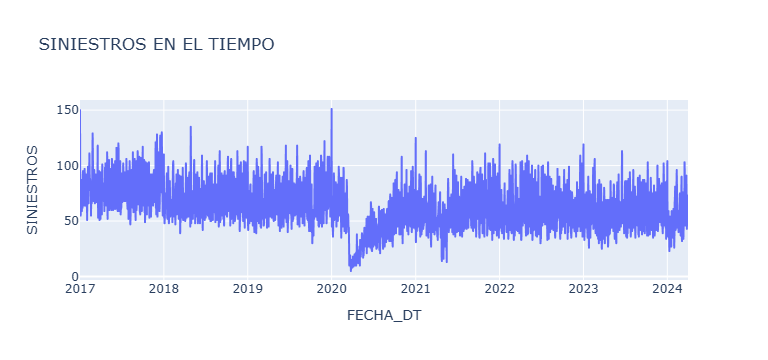

In [18]:
import plotly.express as px
fig = px.line(code_counts, x='FECHA_DT', y='SINIESTROS', title='SINIESTROS EN EL TIEMPO')
fig.show()

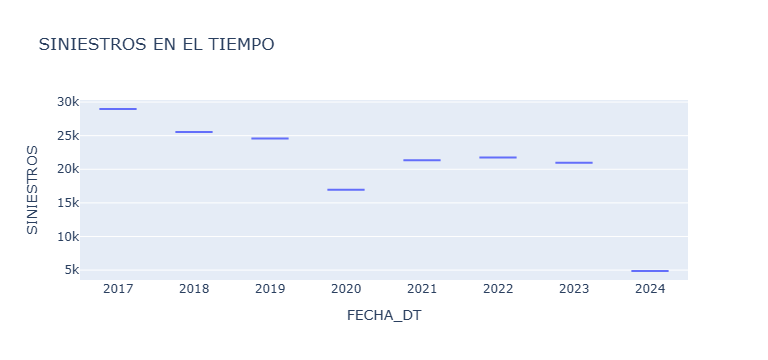

In [19]:
code_counts_year = dataset_cl1.groupby(dataset_cl1['FECHA_DT'].dt.year)['SINIESTROS'].count().reset_index()
fig = px.box(code_counts_year, x='FECHA_DT', y='SINIESTROS', title='SINIESTROS EN EL TIEMPO')
fig.show()

In [20]:
code_counts_year

,FECHA_DT,SINIESTROS
0,2017,28967
1,2018,25530
2,2019,24595
3,2020,16972
4,2021,21352
5,2022,21733
6,2023,20977
7,2024,4866


## Obteniendo datos climáticos

Se consulta *openweather* para obtener datos meteorológicos históricos ya que el clima es un factor a considerar en los accidentes de tránsico

In [21]:
from dotenv import load_dotenv
load_dotenv()
WEATHER_API_KEY1 = os.getenv("WEATHER1")
WEATHER_API_KEY2 = os.getenv("WEATHER2")

In [22]:
WEATHER_API_KEY1, WEATHER_API_KEY2

('4779aeb11ad15e8645f1a09b19626dfa', 'a619efccd952a46b6aecabffd368862d')

In [23]:
import pytz
dataset_cl1['FECHA_DT2'] = dataset_cl1.FECHA_DT
guayaquil_tz = pytz.timezone('America/Guayaquil')
dataset_cl1['FECHA_DT2'] = dataset_cl1['FECHA_DT2'].dt.tz_localize(guayaquil_tz)

C:\Users\entea\AppData\Local\Temp\ipykernel_36724\3925649077.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\entea\AppData\Local\Temp\ipykernel_36724\3925649077.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [24]:
# Convert UTC timestamps (nanoseconds) to Unix timestamps (seconds)
# dataset_cl1['FECHA_DT_UTC_seconds'] = dataset_cl1['FECHA_DT'].dt.tz_localize('America/Guayaquil').dt.tz_convert('UTC').dt.timestamp(unit='ns')/1e9
dataset_cl1['FECHA_DT_UTC_seconds'] = dataset_cl1['FECHA_DT2'].apply(lambda x: x.timestamp())

C:\Users\entea\AppData\Local\Temp\ipykernel_36724\3441007131.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [25]:
dataset_cl1.sample(5)

,NUMERO,ANIO,SINIESTROS,LESIONADOS,FALLECIDOS,ENTE_DE_CONTROL,LATITUD_Y,LONGITUD_X,DPA_1,PROVINCIA,DPA_2,CANTON,DPA_3,PARROQUIA,DIRECCION,ZONA_PLANIFICACION,ZONA,ID_DE_LA_VIA,NOMBRE_DE_LA_VIA,UBICACION_DE_LA_VIA,JERARQUIA_DE_LA_VIA,FECHA,HORA,PERIODO_1,PERIODO_2,DIA_1,DIA_2,MES_1,MES_2,FERIADO,CODIGO_CAUSA,CAUSA_PROBABLE,TIPO_DE_SINIESTRO,TIPO_DE_VEHICULO_1,SERVICIO_1,AUTOMOVIL,BICICLETA,BUS,CAMION,CAMIONETA,EMERGENCIAS,ESPECIAL,FURGONETA,MOTOCICLETA,NO_IDENTIFICADO,SCOOTER_ELECTRICO,TRICIMOTO,VEHICULO_DEPORTIVO_UTILITARIO,SUMA_DE_VEHICULOS,TIPO_ID_1,EDAD_1,SEXO_1,CONDICION_1,PARTICIPANTE_1,CASCO_1,CINTURON_1,DPA_PROV,DPA_CANT,DPA_PARR,GRUPO ETARIO,FECHA_STR,FECHA_STR2,FECHA_DT,FECHA_DT2,FECHA_DT_UTC_seconds
52430,37408,2018,MAM08441052018,2,0,"DIRECCION DE TRANSITO, TRANSPORTE TERRESTRE Y ...",-1.252973,-78.629717,18,TUNGURAHUA,1801,AMBATO,180150,AMBATO,AV LOS SHIRIS Y RUMIÑAHUI,ZONA 3,URBANA,ND,ND,ND,ND,"jueves, 3 de mayo de 2018",13:15:00,DE 13H00 A 13H59,13.0,JUEVES,4.0,MAYO,5.0,NO,C16,NO TRANSITAR POR LAS ACERAS O ZONAS DE SEGURID...,ATROPELLOS,MOTOCICLETA,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,CEDULA,40.0,HOMBRE,LESIONADO,CONDUCTOR PRESENTE,NO,NO,18,1801,180150,DE 40 A 49 AÑOS,"jueves, 3 de mayo de 2018 13:15:00",2018/05/3 13:15:00,2018-05-03 13:15:00,2018-05-03 13:15:00-05:00,1.525371e+09
137126,72590,2019,CTE18093092019,0,0,COMISION DE TRANSITO DEL ECUADOR - CTE,-1.554299,-79.785116,12,LOS RIOS,1208,VINCES,120850,VINCES,RED VIAL E484 VIA VINCES MACUL KM 27 APROX,ZONA 5,RURAL,205,VINCES - LIMITE CON GUAYAS,E484,COLECTORA,"viernes, 27 de septiembre de 2019",17:15:00,DE 17H00 A 17H59,17.0,VIERNES,5.0,SEPTIEMBRE,9.0,NO,C19,REALIZAR CAMBIO BRUSCO O INDEBIDO DE CARRIL.,PERDIDA DE PISTA,VEHICULO DEPORTIVO UTILITARIO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,CEDULA,70.0,HOMBRE,ILESO,CONDUCTOR PRESENTE,NO,SI,12,1208,120850,MAYOR DE 65 AÑOS,"viernes, 27 de septiembre de 2019 17:15:00",2019/09/27 17:15:00,2019-09-27 17:15:00,2019-09-27 17:15:00-05:00,1.569622e+09
36498,5232,2017,DMQ05232032017,0,0,AGENCIA METROPOLITANA DE TRANSITO DE QUITO - AMT,-0.237667,-78.484685,17,PICHINCHA,1701,QUITO,170150,QUITO,SIMON BOLIVAR Y AUTOPISTA GENERAL RUMIÑAHUI,ZONA 9,URBANA,ND,ND,ND,ND,"lunes, 6 de marzo de 2017",11:05:00,DE 11H00 A 11H59,11.0,LUNES,1.0,MARZO,3.0,NO,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,VOLCAMIENTOS,VEHICULO DEPORTIVO UTILITARIO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,NO IDENTIFICADO,-1.0,NO IDENTIFICADO,NO IDENTIFICADO,CONDUCTOR AUSENTE,NO,NO,17,1701,170150,NO IDENTIFICADO,"lunes, 6 de marzo de 2017 11:05:00",2017/03/6 11:05:00,2017-03-06 11:05:00,2017-03-06 11:05:00-05:00,1.488816e+09
127333,56018,2019,CTE01521012019,1,0,COMISION DE TRANSITO DEL ECUADOR - CTE,-2.216533,-80.081066,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,GUAYAQUIL RED ESTATAL E 40 KM 24 VIA A LA COSTA,ZONA 8,RURAL,176,PROGRESO - KM 19.4 VIA GUAYAQUIL / PROGRESO,E40,ARTERIAL,"viernes, 25 de enero de 2019",21:45:00,DE 21H00 A 21H59,21.0,VIERNES,5.0,ENERO,1.0,NO,C14,CONDUCIR DESATENTO A LAS CONDICIONES DE TRANSI...,ATROPELLOS,CAMIONETA,PUBLICO,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,NO IDENTIFICADO,-1.0,NO IDENTIFICADO,LESIONADO,PEATON,NO,NO,9,901,90150,NO IDENTIFICADO,"viernes, 25 de enero de 2019 21:45:00",2019/01/25 21:45:00,2019-01-25 21:45:00,2019-01-25 21:45:00-05:00,1.548471e+09
79328,7344,2017,MAM07344042017,0,0,"DIRECCION DE TRANSITO, TRANSPORTE TERRESTRE Y ...",-1.228705,-78.625717,18,TUNGURAHUA,1801,AMBATO,180150,AMBATO,ESCUELA Y COLEGIO PIO X,ZONA 3,RURAL,ND,ND,ND,ND,"lunes, 3 de abril de 2017",23:26:51,DE 23H00 A 23H59,23.0,LUNES,1.0,ABRIL,4.0,NO,C06,"CONDUCE BAJO LA INFLUENCIA DE ALCOHOL, SUSTANC...",CHOQUE POSTERIOR,AUTOMOVIL,PARTICULAR,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2.0,CEDULA,55.0,HOMBRE,ILESO,CONDUCTOR PRESENTE,NO,NO,18,1801,180150,DE 50 A 64 AÑOS,"lunes, 3 de abril de 2017 23:26:51",2017/04/3 23:26:51,2017-04-03 23:

Obteniendo datos del clima segun latitud, longitud y timestamp, para esto es importante eliminar latitudes y longitudes que no sean del Ecuador

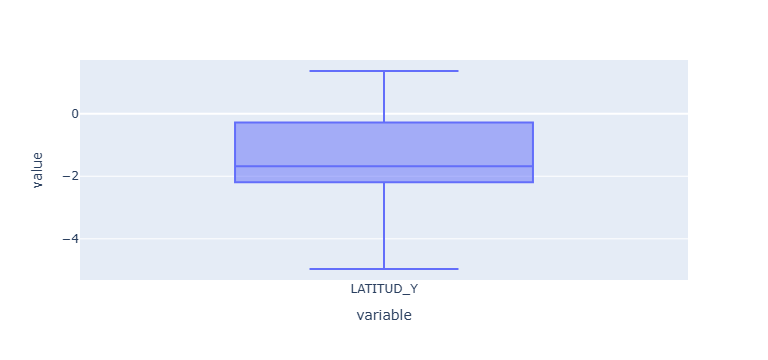

In [26]:
fig = px.box(dataset_cl1['LATITUD_Y'])
fig.show()

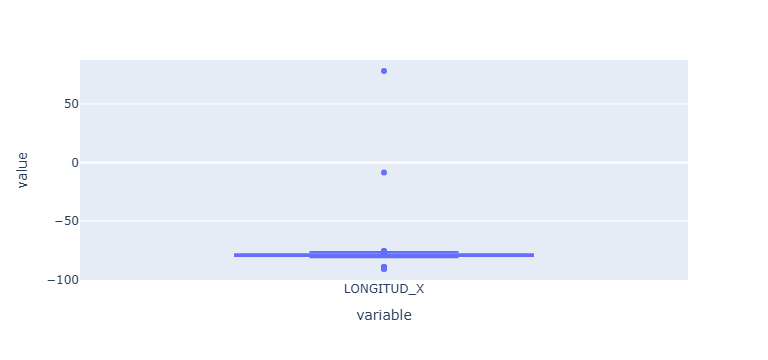

In [27]:
fig = px.box(dataset_cl1['LONGITUD_X'])
fig.show()

In [28]:
dataset_cl1[['LATITUD_Y', 'LONGITUD_X']].describe()

,LATITUD_Y,LONGITUD_X
count,164992.000000,164992.000000
mean,-1.471668,-79.322244
std,1.092690,0.872772
min,-4.966098,-91.108467
25%,-2.195415,-79.905223
50%,-1.681938,-79.443730
75%,-0.279106,-78.551249
max,1.366128,78.170326


In [29]:
dataset_cl1[['LATITUD_Y', 'LONGITUD_X', 'PROVINCIA', 'CANTON']][(dataset_cl1['LATITUD_Y']==-4.966098)|(dataset_cl1['LATITUD_Y']==1.366128)|(dataset_cl1['LONGITUD_X']==-91.108467)|(dataset_cl1['LONGITUD_X']==78.170326)]

,LATITUD_Y,LONGITUD_X,PROVINCIA,CANTON
77862,-0.426332,-91.108467,GALAPAGOS,ISABELA
84899,1.366128,-78.720102,ESMERALDAS,SAN LORENZO
103441,-4.966098,-79.116479,ZAMORA CHINCHIPE,CHINCHIPE
107726,1.366128,-78.720102,ESMERALDAS,SAN LORENZO


In [30]:
# import requests
# def get_historical_weather(lat, lon, start_date, api_key):
#     # base_url = "https://history.openweathermap.org/data/2.5/history/city"
#     base_url = "https://api.openweathermap.org/data/2.5/weather?"
#     params = {
#         "lat": lat,
#         "lon": lon,
#         # "type": "hour",
#         # "start": start_date,
#         "appid": api_key
#     }

#     response = requests.get(base_url, params=params)
#     return response.json()

# example = dataset_cl1[['LATITUD_Y', 'LONGITUD_X', 'FECHA_DT_UTC_seconds', 'FECHA_DT']].iloc[107726]
# get_historical_weather(lat=example.LATITUD_Y, lon=example.LONGITUD_X, start_date=example.FECHA_DT_UTC_seconds, api_key=WEATHER_API_KEY1)

In [31]:
from datetime import datetime
import matplotlib.pyplot as plt
from meteostat import Point, Daily, Hourly

# Set time period
start = datetime(2018, 1, 1)
end = datetime(2018, 12, 31)

# Create Point for Vancouver, BC
vancouver = Point(49.2497, -123.1193, 70)

# Get daily data for 2018
data = Hourly(vancouver, start, end)
data.processes = 6
data.threads = 6
data.chunked = True
data = data.fetch()

# Plot line chart including average, minimum and maximum temperature
# data.plot(y=['tavg', 'tmin', 'tmax'])
# plt.show()

In [32]:
# Import Meteostat library and dependencies
from datetime import datetime
from meteostat import Hourly

# Set time period
start = datetime(2018, 1, 1)
end = datetime(2018, 12, 31, 23, 59)

# Get hourly data
data = Hourly('72219', start, end)
data.processes = 6
data.threads = 6
data.chunked = True
data = data.fetch()

# Print DataFrame
print(data)

                     temp  dwpt  rhum  prcp  snow   wdir  wspd  wpgt    pres  \
time                                                                           
2018-01-01 00:00:00   0.6  -5.6  63.0   NaN   NaN  340.0  18.4   NaN  1024.6   
2018-01-01 01:00:00  -1.1  -6.6  66.0   0.0   NaN  320.0  16.6   NaN  1025.4   
2018-01-01 02:00:00  -1.1  -9.5  53.0   0.0   NaN  330.0  22.3   NaN  1025.8   
2018-01-01 03:00:00  -1.1 -10.0  51.0   0.0   NaN  330.0  25.9   NaN  1025.6   
2018-01-01 04:00:00  -1.7 -10.5  51.0   0.0   NaN  340.0  18.4   NaN  1026.1   
...                   ...   ...   ...   ...   ...    ...   ...   ...     ...   
2018-12-31 19:00:00  20.0  17.2  84.0   0.0   NaN  200.0  18.4   NaN  1016.5   
2018-12-31 20:00:00  21.1  16.7  76.0   0.0   NaN  190.0  22.3   NaN  1015.8   
2018-12-31 21:00:00  21.1  16.1  73.0   0.0   NaN  180.0  27.7   NaN  1014.7   
2018-12-31 22:00:00  21.1  15.0  68.0   0.0   NaN  190.0  27.7   NaN  1015.7   
2018-12-31 23:00:00  20.0  15.0  73.0   

In [33]:
import numpy as np
from datetime import timedelta
from meteostat import Point, Hourly
from tqdm import tqdm


def get_weather_by_position_time(latitude, longitude, start_date):
    end = start_date+timedelta(hours=1)
    ecuadorp = Point(latitude, longitude)
    data = Hourly(ecuadorp, start_date, end)
    data.processes = 6
    data.threads = 6
    data.chunked = True
    data = data.fetch()
    if data.empty:
        return {'temp': np.nan,'dwpt': np.nan,'rhum': np.nan,'prcp': np.nan,'snow': np.nan,'wdir': np.nan,'wspd': np.nan,'wpgt': np.nan,'pres': np.nan,'tsun': np.nan,'coco': np.nan}
    else:
        return data.iloc[0].to_dict()
    

# get_weather_by_position_time(-0.22985, -78.52495, datetime(2023,1,1,16,30))



In [42]:
# %%capture
# # %%capture --no-stderr --no-stdout
# tqdm.pandas()
# dataset_cl1_6k = dataset_cl1.sample(6000)
# dataset_cl1_6k['weather_data'] = dataset_cl1_6k.progress_apply(lambda x: get_weather_by_position_time(x.LATITUD_Y, x.LONGITUD_X, x.FECHA_DT), axis=1)

In [46]:
%%capture
from tqdm.notebook import tqdm
tqdm.pandas()
dataset_cl1['weather_data'] = dataset_cl1.apply(lambda x: get_weather_by_position_time(x.LATITUD_Y, x.LONGITUD_X, x.FECHA_DT), axis=1)

Formateando las nuevas columnas de datos climáticos

In [48]:
from tqdm import tqdm
weather_dict = {'temp': np.nan,'dwpt': np.nan,'rhum': np.nan,'prcp': np.nan,'snow': np.nan,'wdir': np.nan,'wspd': np.nan,'wpgt': np.nan,'pres': np.nan,'tsun': np.nan,'coco': np.nan}
def create_weather_cols(df, weather_col='weather_data', weather_dict=weather_dict):
    for key in tqdm(weather_dict.keys()):
        df['CLIMA_'+key.upper()] = df[weather_col].apply(lambda x: x.get(key))

create_weather_cols(dataset_cl1)


  0%|                                                                | 0/11 [00:00<?, ?it/s]SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

 18%|██████████▏                                             | 2/11 [00:00<00:00, 11.95it/s]SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#return

In [64]:
dataset_cl1.head()

,NUMERO,ANIO,SINIESTROS,LESIONADOS,FALLECIDOS,ENTE_DE_CONTROL,LATITUD_Y,LONGITUD_X,DPA_1,PROVINCIA,DPA_2,CANTON,DPA_3,PARROQUIA,DIRECCION,ZONA_PLANIFICACION,ZONA,ID_DE_LA_VIA,NOMBRE_DE_LA_VIA,UBICACION_DE_LA_VIA,JERARQUIA_DE_LA_VIA,FECHA,HORA,PERIODO_1,PERIODO_2,DIA_1,DIA_2,MES_1,MES_2,FERIADO,CODIGO_CAUSA,CAUSA_PROBABLE,TIPO_DE_SINIESTRO,TIPO_DE_VEHICULO_1,SERVICIO_1,AUTOMOVIL,BICICLETA,BUS,CAMION,CAMIONETA,EMERGENCIAS,ESPECIAL,FURGONETA,MOTOCICLETA,NO_IDENTIFICADO,SCOOTER_ELECTRICO,TRICIMOTO,VEHICULO_DEPORTIVO_UTILITARIO,SUMA_DE_VEHICULOS,TIPO_ID_1,EDAD_1,SEXO_1,CONDICION_1,PARTICIPANTE_1,CASCO_1,CINTURON_1,DPA_PROV,DPA_CANT,DPA_PARR,GRUPO ETARIO,FECHA_STR,FECHA_STR2,FECHA_DT,FECHA_DT2,FECHA_DT_UTC_seconds,weather_data,CLIMA_TEMP,CLIMA_DWPT,CLIMA_RHUM,CLIMA_PRCP,CLIMA_SNOW,CLIMA_WDIR,CLIMA_WSPD,CLIMA_WPGT,CLIMA_PRES,CLIMA_TSUN,CLIMA_COCO
0,890,2017,ATM00890012017,1,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.188101,-79.878093,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,AV. MALECON ENTRE TOMAS MARTINEZ E IMBABURA,ZONA 8,URBANA,ND,ND,ND,ND,"jueves, 12 de enero de 2017",13:30:00,DE 13H00 A 13H59,13.0,JUEVES,4.0,ENERO,1.0,NO,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,ATROPELLOS,NO IDENTIFICADO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,CEDULA,-1.0,HOMBRE,LESIONADO,PEATON,NO,NO,9,901,90150,NO IDENTIFICADO,"jueves, 12 de enero de 2017 13:30:00",2017/01/12 13:30:00,2017-01-12 13:30:00,2017-01-12 13:30:00-05:00,1.484246e+09,"{'temp': 28.0, 'dwpt': 21.1, 'rhum': 66.0, 'pr...",28.0,21.1,66.0,NaN,NaN,360.0,7.6,NaN,NaN,NaN,NaN
1,1206,2017,ATM01206012017,1,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.240041,-79.917687,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,AV. PERIMETRAL A LA ALTURA DE LA BOMBA DE INTE...,ZONA 8,URBANA,ND,ND,ND,ND,"lunes, 16 de enero de 2017",08:10:00,DE 08H00 A 08H59,8.0,LUNES,1.0,ENERO,1.0,NO,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,ATROPELLOS,NO IDENTIFICADO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,CEDULA,-1.0,HOMBRE,LESIONADO,PEATON,NO,NO,9,901,90150,NO IDENTIFICADO,"lunes, 16 de enero de 2017 08:10:00",2017/01/16 08:10:00,2017-01-16 08:10:00,2017-01-16 08:10:00-05:00,1.484572e+09,"{'temp': 25.0, 'dwpt': 21.9, 'rhum': 83.0, 'pr...",25.0,21.9,83.0,NaN,NaN,220.0,9.4,NaN,NaN,NaN,NaN
2,2204,2017,ATM02204012017,1,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.218838,-79.919551,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,YAGUACHI Y FRANCISCO PAREDES HERRERA,ZONA 8,URBANA,ND,ND,ND,ND,"sábado, 28 de enero de 2017",20:30:00,DE 20H00 A 20H59,20.0,SABADO,6.0,ENERO,1.0,NO,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,ATROPELLOS,NO IDENTIFICADO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,CEDULA,-1.0,HOMBRE,LESIONADO,PEATON,NO,NO,9,901,90150,NO IDENTIFICADO,"sábado, 28 de enero de 2017 20:30:00",2017/01/28 20:30:00,2017-01-28 20:30:00,2017-01-28 20:30:00-05:00,1.485653e+09,"{'temp': 29.9, 'dwpt': 22.9, 'rhum': 66.0, 'pr...",29.9,22.9,66.0,NaN,NaN,150.0,9.4,NaN,1006.3,NaN,NaN
3,3586,2017,ATM03586022017,1,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.143004,-79.902988,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,AV. JUAN TANCA MARENGO Y CALLE 17 DE LA ALBORADA,ZONA 8,URBANA,ND,ND,ND,ND,"martes, 14 de febrero de 2017",22:40:00,DE 22H00 A 22H59,22.0,MARTES,2.0,FEBRERO,2.0,NO,C09,CONDUCIR VEHICULO SUPERANDO LOS LIMITES MAXIMO...,ATROPELLOS,NO IDENTIFICADO,PARTICULAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,CEDULA,-1.0,HOMBRE,LESIONADO,PEATON,NO,NO,9,901,90150,NO IDENTIFICADO,"martes, 14 de febrero de 2017 22:40:00",2017/02/14 22:40:00,2017-02-14 22:40:00,2017-02-14 22:40:00-05:00,1.487130e+09,"{'temp': 31.0, 'dwpt': 22.9, 'rhum': 62.0, 'pr...",31.0,22.9,62.0,NaN,NaN,NaN,3.6,NaN,NaN,NaN,NaN
4,3588,2017,ATM03588022017,1,0,AGENCIA DE TRANSITO Y MOVILIDAD DE GUAYAQUIL -...,-2.144131,-79.918262,9,GUAYAS,901,GUAYAQUIL,90150,GUAYAQUIL,AV. JUAN TANCA MARENGO KM 41/5 A LA ALTURA DE ...,ZONA 8,URBANA,ND,ND

In [50]:
dataset_cl1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 164992 entries, 0 to 165016
Data columns (total 77 columns):
 #   Column                         Non-Null Count   Dtype                            
---  ------                         --------------   -----                            
 0   NUMERO                         164992 non-null  int64                            
 1   ANIO                           164992 non-null  int64                            
 2   SINIESTROS                     164992 non-null  object                           
 3   LESIONADOS                     164992 non-null  int64                            
 4   FALLECIDOS                     164992 non-null  int64                            
 5   ENTE_DE_CONTROL                164992 non-null  object                           
 6   LATITUD_Y                      164992 non-null  float64                          
 7   LONGITUD_X                     164992 non-null  float64                          
 8   DPA_1              

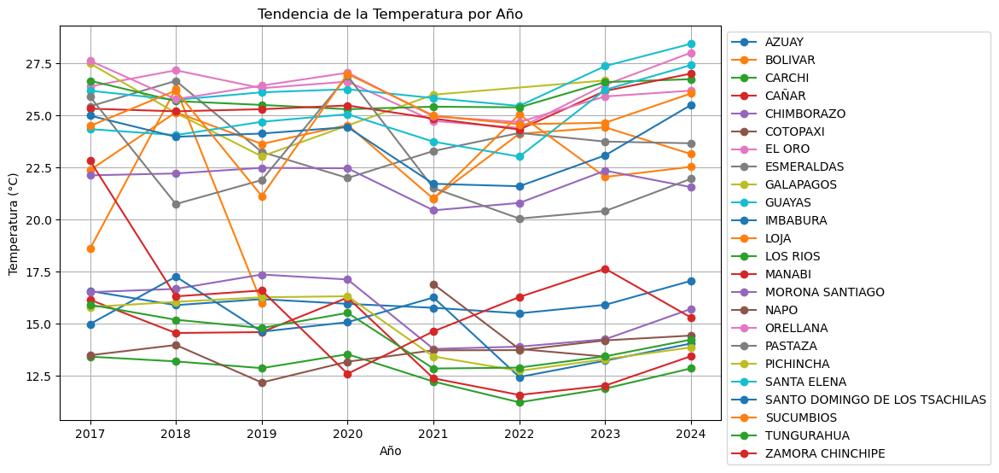

In [61]:
temp_data = dataset_cl1.groupby(["ANIO", "PROVINCIA"])["CLIMA_TEMP"].mean().reset_index()
# temp_data_prov = temp_data[temp_data.PROVINCIA=="GUAYAS"]
plt.figure(figsize=(10, 6))
for provincia, group in temp_data.groupby('PROVINCIA'):
    plt.plot(group['ANIO'], group['CLIMA_TEMP'], marker='o', linestyle='-', label=provincia)
    
plt.title('Tendencia de la Temperatura por Año')
plt.xlabel('Año')
plt.ylabel('Temperatura (°C)')
plt.grid(True)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.show()

## Completando datos de climáticos
Los datos de temperatura y climáticos se obtuvieron utilizando la librería *meteostat* (https://dev.meteostat.net/python/#example) que facilita la extracción de datos históricos por hora de variables como temperatura, humedad, presión, precipitación velocidad del viento, y 27 categorías de tipos de climas. Sin embargo, los datos no existen para todas las latitudes y longitudes del dataset. A fin de completar los datos, se asume que no afecte las predicciones el que los valores de un cantón, si no existen, sean los mismos que la provincia.  


In [67]:
dataset_cl1[['PROVINCIA', 'CANTON', 'LATITUD_Y', 'LONGITUD_X', 'CLIMA_TEMP', 'CLIMA_COCO', 'FECHA_DT', 'DPA_PROV', 'DPA_CANT', 'DPA_PARR']][dataset_cl1.PROVINCIA=="PICHINCHA"]

,PROVINCIA,CANTON,LATITUD_Y,LONGITUD_X,CLIMA_TEMP,CLIMA_COCO,FECHA_DT,DPA_PROV,DPA_CANT,DPA_PARR
25888,PICHINCHA,QUITO,-0.249981,-78.482783,NaN,NaN,2017-01-21 04:01:00,17,1701,170150
25889,PICHINCHA,QUITO,-0.244084,-78.485321,NaN,NaN,2017-02-05 00:20:00,17,1701,170150
25890,PICHINCHA,QUITO,-0.245276,-78.484893,NaN,NaN,2017-03-02 15:30:00,17,1701,170150
25891,PICHINCHA,QUITO,-0.243628,-78.485199,NaN,NaN,2017-07-25 06:50:00,17,1701,170150
25892,PICHINCHA,QUITO,-0.246607,-78.484416,NaN,NaN,2017-12-16 13:40:00,17,1701,170150
...,...,...,...,...,...,...,...,...,...,...
164141,PICHINCHA,MEJIA,-0.437427,-78.704432,5.4,3.0,2023-01-21 07:50:00,17,1703,170351
164179,PICHINCHA,MEJIA,-0.467078,-78.590583,12.4,3.0,2023-06-25 13:42:00,17,1703,170351
164192,PICHINCHA,MEJIA,-0.467056,-78.587056,18.3,3.0,2023-08-02 15:40:00,17,1703,170351
164203,PICHINCHA,MEJIA,-0.451584,-78.685226,13.8,9.0,2023-09-23 21:30:00,17,1703,170351


El dataset está organizado por registros históricos y se dispone adicionalmente de los códigos DPA que nos señalan una pertenencia geopolítica. Se realizará la interpolación de datos en función del valor medio histórico, considerando como restricción la pertenencia geopolítica.

In [87]:
dataset_cl1_filled = dataset_cl1.copy()
dataset_cl1_filled.drop(columns=['CLIMA_SNOW', 'CLIMA_TSUN', 'CLIMA_WPGT'], inplace=True)
temperatura_cols = [col for col in dataset_cl1_filled.columns if 'CLIMA' in col]
temperatura_cols

['CLIMA_TEMP',
 'CLIMA_DWPT',
 'CLIMA_RHUM',
 'CLIMA_PRCP',
 'CLIMA_WDIR',
 'CLIMA_WSPD',
 'CLIMA_PRES',
 'CLIMA_COCO']

In [88]:
from tqdm import tqdm
temperatura_mean_values_dict = {}
for clima_key in tqdm(temperatura_cols):
    # calculo los valores medios de temperatura agrupando por DPA de Provincia
    temperatura_mean_values_dict[clima_key] = dataset_cl1_filled.groupby('DPA_PROV')[clima_key].mean()
    # se llenan las variables en donde estas no tengan dato
    dataset_cl1_filled[clima_key] = dataset_cl1_filled.apply(lambda row: temperatura_mean_values_dict[clima_key][row['DPA_PROV']] if np.isnan(row[clima_key]) else row[clima_key], axis=1)
    


100%|█████████████████████████████████████████████████████████| 8/8 [00:24<00:00,  3.04s/it]


In [86]:
temperatura_mean_values_dict['CLIMA_TEMP']

DPA_PROV
1     16.040945
2     23.404918
3     13.743666
4     12.682059
5     13.709489
6     14.889035
7     25.403255
8     24.151546
9     26.193895
10    14.650253
11    23.067021
12    25.814892
13    25.225820
14    21.752914
15    14.313333
16    20.908943
17    14.756308
18    14.034820
19    16.638298
20    25.377778
21    25.126531
22    25.817049
23    22.687604
24    24.479889
90    13.500000
Name: CLIMA_TEMP, dtype: float64

Dado que CLIMA_COCO son valores enteros se puede cambiar a tipo entero. Sin embargo, existen valores fuera de la tabla, concretamente existen casos en eque la librería devolvió el valor de 0 que no consta dentro de las categorías. Por tanto, para evitar esta condición se ha de sustituir los valores de 0 con los valores promedio según DPA de Provincia

In [89]:
dataset_cl1_filled['CLIMA_COCO'] = dataset_cl1_filled.apply(lambda row: temperatura_mean_values_dict['CLIMA_COCO'][row['DPA_PROV']] if row['CLIMA_COCO']<1.0 else row['CLIMA_COCO'], axis=1)

In [90]:
dataset_cl1_filled.CLIMA_COCO = dataset_cl1_filled.CLIMA_COCO.astype(int)

In [91]:
dataset_cl1_filled[['PROVINCIA', 'CANTON', 'LATITUD_Y', 'LONGITUD_X', 'CLIMA_TEMP', 'CLIMA_COCO', 'FECHA_DT', 'DPA_PROV', 'DPA_CANT', 'DPA_PARR']][dataset_cl1_filled.PROVINCIA=="PICHINCHA"]

,PROVINCIA,CANTON,LATITUD_Y,LONGITUD_X,CLIMA_TEMP,CLIMA_COCO,FECHA_DT,DPA_PROV,DPA_CANT,DPA_PARR
25888,PICHINCHA,QUITO,-0.249981,-78.482783,14.756308,4,2017-01-21 04:01:00,17,1701,170150
25889,PICHINCHA,QUITO,-0.244084,-78.485321,14.756308,4,2017-02-05 00:20:00,17,1701,170150
25890,PICHINCHA,QUITO,-0.245276,-78.484893,14.756308,4,2017-03-02 15:30:00,17,1701,170150
25891,PICHINCHA,QUITO,-0.243628,-78.485199,14.756308,4,2017-07-25 06:50:00,17,1701,170150
25892,PICHINCHA,QUITO,-0.246607,-78.484416,14.756308,4,2017-12-16 13:40:00,17,1701,170150
...,...,...,...,...,...,...,...,...,...,...
164141,PICHINCHA,MEJIA,-0.437427,-78.704432,5.400000,3,2023-01-21 07:50:00,17,1703,170351
164179,PICHINCHA,MEJIA,-0.467078,-78.590583,12.400000,3,2023-06-25 13:42:00,17,1703,170351
164192,PICHINCHA,MEJIA,-0.467056,-78.587056,18.300000,3,2023-08-02 15:40:00,17,1703,170351
164203,PICHINCHA,MEJIA,-0.451584,-78.685226,13.800000,9,2023-09-23 21:30:00,17,1703,170351


In [92]:
dataset_cl1_filled.info()

<class 'pandas.core.frame.DataFrame'>
Index: 164992 entries, 0 to 165016
Data columns (total 74 columns):
 #   Column                         Non-Null Count   Dtype                            
---  ------                         --------------   -----                            
 0   NUMERO                         164992 non-null  int64                            
 1   ANIO                           164992 non-null  int64                            
 2   SINIESTROS                     164992 non-null  object                           
 3   LESIONADOS                     164992 non-null  int64                            
 4   FALLECIDOS                     164992 non-null  int64                            
 5   ENTE_DE_CONTROL                164992 non-null  object                           
 6   LATITUD_Y                      164992 non-null  float64                          
 7   LONGITUD_X                     164992 non-null  float64                          
 8   DPA_1              

Finalmente se crea una columna con las categorías respectivas de tipo de clima partiendo de un diccinario de datos



In [93]:
weather_dict = {
    1: "Despejado",
    2: "Buen tiempo",
    3: "Nublado",
    4: "Cubierto",
    5: "Niebla",
    6: "Niebla congelante",
    7: "Lluvia ligera",
    8: "Lluvia",
    9: "Lluvia intensa",
    10: "Lluvia congelante",
    11: "Lluvia intensa congelante",
    12: "Aguanieve",
    13: "Aguanieve intensa",
    14: "Nevadas ligeras",
    15: "Nevadas",
    16: "Nevadas intensas",
    17: "Chubascos de lluvia",
    18: "Chubascos de lluvia intensa",
    19: "Chubascos de aguanieve",
    20: "Chubascos de aguanieve intensa",
    21: "Chubascos de nieve",
    22: "Chubascos de nieve intensa",
    23: "Relámpagos",
    24: "Granizo",
    25: "Tormenta eléctrica",
    26: "Tormenta eléctrica intensa",
    27: "Tormenta"
}

dataset_cl1_filled['CLIMA_CONDICION'] = dataset_cl1_filled.CLIMA_COCO.apply(lambda x: weather_dict[x] if x in weather_dict.keys() else np.nan)


In [94]:
# temperatura_mean_values_dict['CLIMA_COCO']
dataset_cl1_filled.CLIMA_COCO.describe()

count    164992.000000
mean          3.992151
std           2.299589
min           1.000000
25%           3.000000
50%           3.000000
75%           4.000000
max          27.000000
Name: CLIMA_COCO, dtype: float64

In [99]:
dataset_cl1.loc[50744:50750,['CLIMA_COCO']] 

,CLIMA_COCO
50744,NaN
50745,0.0
50746,NaN
50747,NaN
50748,NaN
50749,NaN
50750,NaN


In [100]:
dataset_cl1_filled.loc[50744:50750,['CLIMA_COCO', 'CLIMA_CONDICION']] 

,CLIMA_COCO,CLIMA_CONDICION
50744,6,Niebla congelante
50745,5,Niebla
50746,6,Niebla congelante
50747,4,Cubierto
50748,4,Cubierto
50749,2,Buen tiempo
50750,6,Niebla congelante


## Salvando Dataset
Se procede a guardar el dataset. El dataset coloca en formato datetime las fechas para mejorar el procesamiento en el tiempo y adiciona datos *aproximados* de tiempo

In [101]:
dataset_cl1_filled.to_csv(os.path.join(os.getcwd(), 'data', 'dataset_with_weather.csv'))